In [258]:

import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter 
import folium
import seaborn as sns
from sklearn.preprocessing import OneHotEncoder

In [211]:
df = pd.read_csv('C:/Users/ashis/OneDrive/Desktop/Data Science/Datasets/Houseprice.csv')

In [212]:
display(df)

,number,property_id,location_id,page_url,property_type,price,location,city,province_name,latitude,longitude,baths,purpose,bedrooms,date_added,agency,agent,Total_Area
0,0,237062,3325,https://www.zameen.com/Property/g_10_g_10_2_gr...,Flat,10000000,G-10,Islamabad,Islamabad Capital,33.679890,73.012640,2,For Sale,2,2/4/2019,NaN,NaN,1089.004
1,1,346905,3236,https://www.zameen.com/Property/e_11_2_service...,Flat,6900000,E-11,Islamabad,Islamabad Capital,33.700993,72.971492,3,For Sale,3,5/4/2019,NaN,NaN,15246.056
2,2,386513,764,https://www.zameen.com/Property/islamabad_g_15...,House,16500000,G-15,Islamabad,Islamabad Capital,33.631486,72.926559,6,For Sale,5,7/17/2019,NaN,NaN,2178.008
3,3,656161,340,https://www.zameen.com/Property/islamabad_bani...,House,43500000,Bani Gala,Islamabad,Islamabad Capital,33.707573,73.151199,4,For Sale,4,4/5/2019,NaN,NaN,10890.000
4,4,841645,3226,https://www.zameen.com/Property/dha_valley_dha...,House,7000000,DHA Defence,Islamabad,Islamabad Capital,33.492591,73.301339,3,For Sale,3,7/10/2019,Easy Property,Muhammad Junaid Ceo Muhammad Shahid Director,2178.008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168441,168441,17355248,6754,https://www.zameen.com/Property/gulshan_e_maym...,House,26500000,Gadap Town,Karachi,Sindh,25.029909,67.137192,0,For Sale,6,7/18/2019,Al Shahab Enterprises,Shahmir,26136.096
168442,168442,17355249,680,https://www.zameen.com/Property/gadap_town_gul...,House,12500000,Gadap Town,Karachi,Sindh,25.017951,67.136393,0,For Sale,3,7/18/2019,Al Shahab Enterprises,Shahmir,2178.008
168443,168443,17355250,6757,https://www.zameen.com/Property/gulshan_e_maym...,House,27000000,Gadap Town,Karachi,Sindh,25.015384,67.116330,0,For Sale,6,7/18/2019,Al Shahab Enterprises,Shahmir,26136.096
168444,168444,17355251,6752,https://www.zameen.com/Property/gulshan_e_maym...,House,11000000,Gadap Town,Karachi,Sindh,25.013265,67.120818,0,For Sale,3,7/18/2019,Al Shahab Enterprises,Shahmir,21235.578


In [213]:
df.drop(df.columns[0], axis=1, inplace=True)

In [214]:
columns_to_drop = ['page_url', 'agency', 'agent']
df.drop(columns=columns_to_drop, inplace=True)

In [215]:
df.isnull().sum()

property_id      0
location_id      0
property_type    0
price            0
location         0
city             0
province_name    0
latitude         0
longitude        0
baths            0
purpose          0
bedrooms         0
date_added       0
Total_Area       0
dtype: int64

In [216]:
zero_price_locations = df[df['price'] == 0]['location_id']

# Print the location IDs
for location_id in zero_price_locations:
    print(location_id)

8129
12395
1058


In [217]:
# Define the location IDs to be dropped
location_ids_to_drop = [8129, 12395, 1058]

# Drop the rows with specified location IDs
df = df[~df['location_id'].isin(location_ids_to_drop)]


In [218]:
zero_price_locations = df[df['price'] <=10000]['location_id']

# Print the location IDs
for location_id in zero_price_locations:
    print(location_id)

6858
6858
6705
8580
4917
5021
7056
531
1378
156
4988
649
1156
6589
3105
616
3421
3352
1314
1314
1019
3041
7163
8484
3071
3041
1420
9780
7130
3048
340
3110
282
3104
11090
9205
168
255
1421
6013
3420
4904
3498
3937
423
10393
10393
3078
1387
3111
339
10073
348
3106
1314
339
3111
3333
168
8551
712
7056
6585
6585
424
5047
329
329
1378
12353
476
6843
6590
424
232
678
8917
170
3390
718
718
10777
282
1362
712
6651
1033
8130
3333
1039
8245
3047
3047
232
233
717
10504
737
10514
8917
233
3496
3333
8128
9514
3461
9020
533
8130
4992
232
12378
1378
709
1483
233
1314
5988
12008
575
1039
1387
3104
8130
156
8275
10652
3047
6678
1673
1039
651
8275
352
7158
3498
329
166
3104
678
3500
632
1146
534
4930
1421
768
10393
338
10393
3492
3234
6053
3078
12199
437
13
10322
4898
9244
6871
6871
348
8130
12001
1026
8275
9991
737
3069
338
330
8122
6842
3337
3230
338
12029
9407
8493
534
338
3420
3508
582
340
424
8227
3280
4967
6935
1039
6843
3337
8410
534
338
3337
1681
3500
438
582
3500
1314
1271
12008
167
5040
5040
1

In [219]:
columns_to_check = ['property_id', 'location_id', 'property_type', 'price', 'location', 'city', 'province_name', 'latitude', 'longitude', 'baths', 'purpose','date_added', 'bedrooms', 'Total_Area']

for column in columns_to_check:
    unique_values = df[column].unique()
    print(f"Unique values in {column}: {unique_values}")

Unique values in property_id: [  237062   346905   386513 ... 17355250 17355251 17355287]
Unique values in location_id: [ 3325  3236   764 ...  9782 13962 13689]
Unique values in property_type: ['Flat' 'House' 'Penthouse' 'Farm House' 'Lower Portion' 'Upper Portion'
 'Room']
Unique values in price: [10000000  6900000 16500000 ...  9010000  1247000   421000]
Unique values in location: ['G-10' 'E-11' 'G-15' ... 'Samanzar Colony' 'Shahra-e-Liaquat' 'Sundar']
Unique values in city: ['Islamabad' 'Lahore' 'Faisalabad' 'Rawalpindi' 'Karachi']
Unique values in province_name: ['Islamabad Capital' 'Punjab' 'Sindh']
Unique values in latitude: [33.67989    33.700993   33.631486   ... 33.504357   24.967166
 31.37656739]
Unique values in longitude: [73.01264    72.971492   72.926559   ... 73.040507   67.153288
 74.17434433]
Unique values in baths: [  2   3   6   4   8   7   5   0   1  10   9  11  13  12 403  14]
Unique values in purpose: ['For Sale' 'For Rent']
Unique values in date_added: ['2/4/201

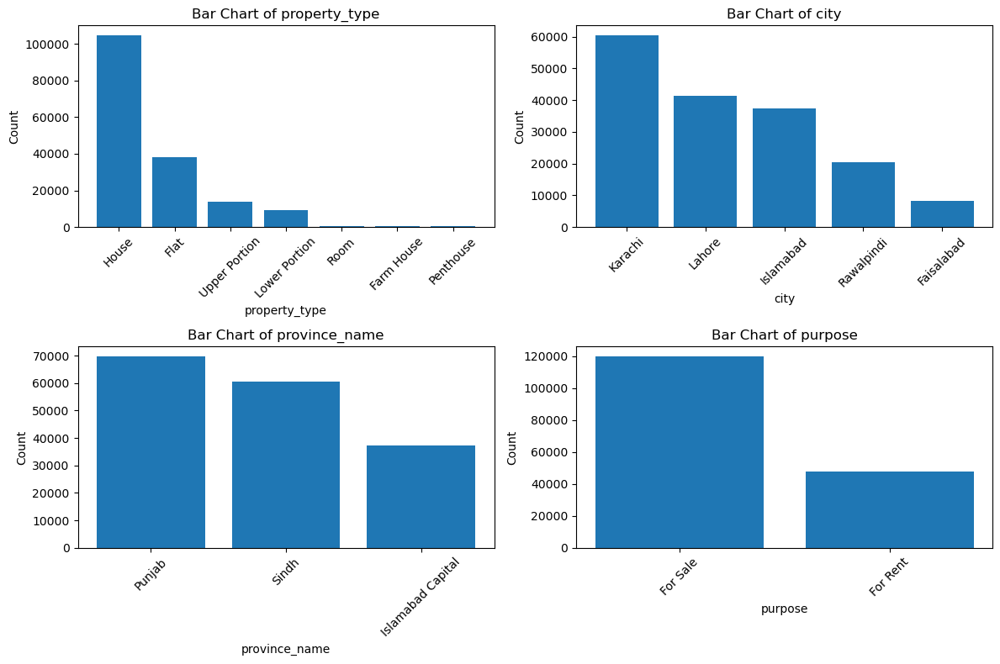

In [220]:
columns = ['property_type', 'city', 'province_name', 'purpose']
num_columns = 2
num_rows = int(len(columns) / num_columns) + (len(columns) % num_columns > 0)  # Calculate the number of rows for the subplots

fig, axs = plt.subplots(num_rows, num_columns, figsize=(12, 8))  # Create the subplots

# Iterate over the columns and plot in the subplots
for i, column in enumerate(columns):
    row = i // num_columns  # Calculate the row index for the subplot
    col = i % num_columns  # Calculate the column index for the subplot
    
    # Calculate the counts or frequencies of each unique value in the column
    value_counts = df[column].value_counts()
    
    # Plot in the respective subplot
    axs[row, col].bar(value_counts.index, value_counts.values)
    axs[row, col].set_xlabel(column)
    axs[row, col].set_ylabel('Count')
    axs[row, col].set_title('Bar Chart of {}'.format(column))
    axs[row, col].tick_params(axis='x', rotation=45)

if len(columns) < num_rows * num_columns:
    for i in range(len(columns), num_rows * num_columns):
        fig.delaxes(axs.flatten()[i])


# Adjust the spacing between subplots
plt.tight_layout()

# Show the plot
plt.show()


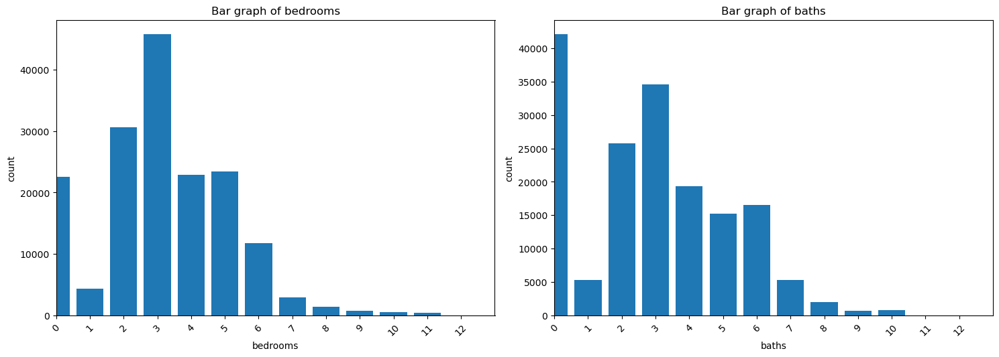

In [221]:
columns = ['bedrooms', 'baths']
num_columns = 2
num_rows: (len(columns)//num_columns)+ (len(columns)%num_columns)
x_value = np.arange(0, 13)

fig, axs = plt.subplots(num_rows, num_columns, figsize=(15, 10)) 

for i,column in enumerate(columns):
    row= i//num_rows 
    col= i%2
    
    value_count= df[column].value_counts() 
    
    
    axs[row,col].bar(value_count.index, value_count.values)
    axs[row,col].set_xlabel(column)
    axs[row,col].set_ylabel('count')
    axs[row,col].set_title('Bar graph of {}'.format(column))
    axs[row,col].tick_params(axis='x',rotation=45)
    axs[row, col].set_xticks(x_value)
    axs[row, col].set_xlim(0, 13)

    
if len(columns) < num_rows * num_columns:
    for i in range(len(columns), num_rows * num_columns):
        fig.delaxes(axs.flatten()[i])

plt.tight_layout()
plt.show()


Property_type and price

In [222]:
property_counts = df.groupby([ 'property_type', 'price']).size()
print(property_counts)

property_type  price    
Farm House     3            1
               12000        1
               15000        2
               16000        2
               20000        2
                           ..
Upper Portion  75000000     1
               80000000     1
               85000000     1
               110000000    1
               375000000    1
Length: 3872, dtype: int64


In [223]:
# Calculate the mean price for each property type
mean_prices = df.groupby('property_type')['price'].mean()

# Calculate the median price for each property type
median_prices = df.groupby('property_type')['price'].median()

# Calculate the maximum price for each property type
max_prices = df.groupby('property_type')['price'].max()

# Combine the summary statistics into a single DataFrame
summary_stats = pd.DataFrame({'mean_price': mean_prices/1000000, 'median_price': median_prices/1000000, 'max_price': max_prices/1000000})

# Sort the DataFrame by mean price in descending order
summary_stats = summary_stats.sort_values(by='mean_price', ascending=False)

# Print the summary statistics
print(summary_stats)
print('---------prices in millions--------- ')

               mean_price  median_price  max_price
property_type                                     
Farm House      59.430300        35.000      884.0
House           24.621553        13.500     2000.0
Penthouse       16.830329         7.000      150.0
Flat             8.255551         5.500      225.0
Upper Portion    2.125565         0.050      375.0
Lower Portion    1.349998         0.040       70.0
Room             0.450044         0.015       90.0
---------prices in millions--------- 


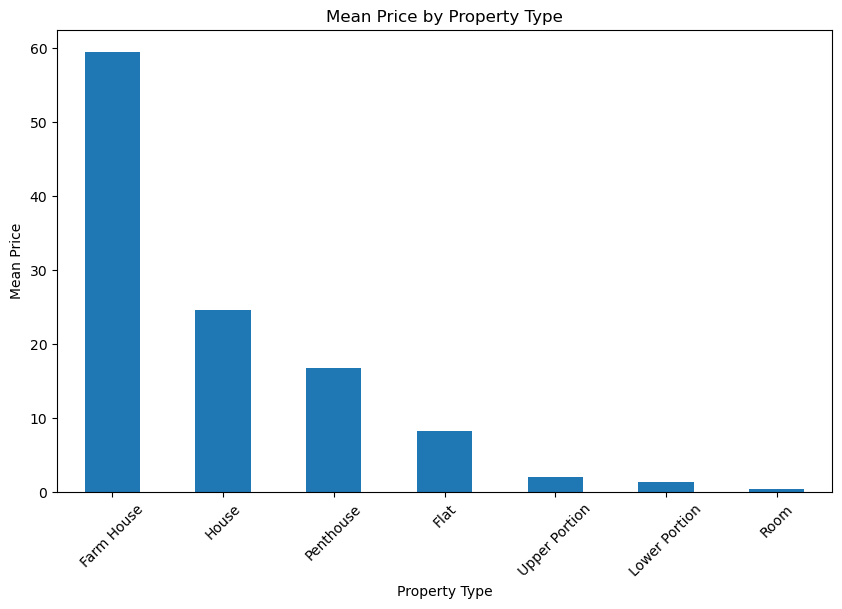

In [224]:
summary_stats['mean_price'].plot(kind='bar', figsize=(10, 6))
plt.title('Mean Price by Property Type')
plt.xlabel('Property Type')
plt.ylabel('Mean Price')
plt.xticks(rotation=45)
plt.show()

In [225]:
# Sort the DataFrame by price in descending order and get the top 10 rows
top_10_houses = df.nlargest(10, 'price')

# Select the desired columns
columns_to_print = ['price', 'property_type', 'city', 'location_id']
top_10_houses_selected = top_10_houses[columns_to_print]

# Print the selected columns for the top 10 houses
print(top_10_houses_selected)

            price property_type     city  location_id
85499  2000000000         House   Lahore          107
58032  1450000000         House  Karachi         8292
68867  1430000000         House   Lahore            7
77087  1350000000         House  Karachi         8292
15320  1270000000         House   Lahore            7
84     1250000000         House   Lahore         3852
74283  1250000000         House   Lahore            7
312    1200000000         House   Lahore         3852
55589  1000000000         House  Karachi            5
95572  1000000000         House   Lahore            7


In [226]:
# Sort the DataFrame by price in ascending order and get the top 10 rows
bottom_10_houses = df.nsmallest(10, 'price')

# Select the desired columns
columns_to_print = ['price', 'property_type', 'city', 'location_id']
bottom_10_houses_selected = bottom_10_houses[columns_to_print]

# Print the selected columns for the bottom 10 houses
print(bottom_10_houses_selected)


        price property_type        city  location_id
9808        1         House      Lahore         3937
74134       1         House     Karachi         6678
156148      1         House     Karachi         6837
156361      1         House  Rawalpindi         3053
160908      1         House   Islamabad        10652
162480      1         House  Rawalpindi         6036
167202      1          Flat     Karachi          495
102235      3         House  Rawalpindi         1312
165482      3    Farm House  Rawalpindi          467
9809        4         House      Lahore          423


Property_type and city 

In [227]:
property_counts = df.groupby([ 'property_type', 'city']).size()
print(property_counts)

property_type  city      
Farm House     Faisalabad        5
               Islamabad       240
               Karachi          73
               Lahore          274
               Rawalpindi       64
Flat           Faisalabad       46
               Islamabad      7114
               Karachi       27000
               Lahore         1640
               Rawalpindi     2429
House          Faisalabad     6760
               Islamabad     19912
               Karachi       25259
               Lahore        39365
               Rawalpindi    13580
Lower Portion  Faisalabad      433
               Islamabad      4250
               Karachi        2681
               Lahore           59
               Rawalpindi     1778
Penthouse      Faisalabad        2
               Islamabad        49
               Karachi         319
               Lahore           12
               Rawalpindi       13
Room           Faisalabad       97
               Islamabad       377
               Karachi       

<Figure size 1400x800 with 0 Axes>

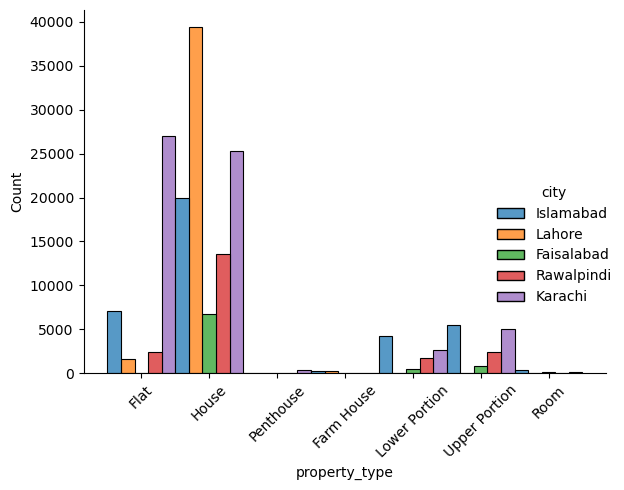

In [228]:
plt.figure(figsize=(14, 8))
sns.displot(df, x="property_type", hue="city", multiple="dodge")
plt.tick_params(axis='x', rotation=45)  # Rotate the x-axis labels by 45 degrees
plt.tight_layout()  # Adjust the spacing to prevent overlapping
plt.show()


In [229]:
property_counts = df.groupby("property_type").size()
print(property_counts)

property_type
Farm House          656
Flat              38229
House            104876
Lower Portion      9201
Penthouse           395
Room                685
Upper Portion     13735
dtype: int64


<Figure size 1500x700 with 0 Axes>

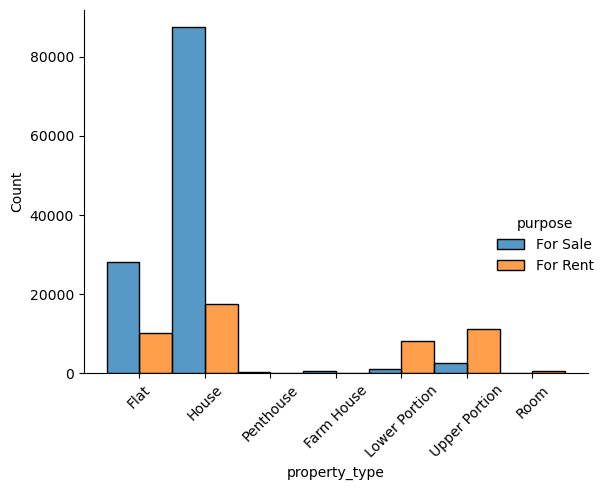

In [230]:
plt.figure(figsize=(15,7))
sns.displot(df, x="property_type", hue="purpose", multiple="dodge")
plt.tick_params(axis='x', rotation=45)  # Rotate the x-axis labels by 45 degrees
plt.tight_layout()  # Adjust the spacing to prevent overlapping
plt.show()


<Figure size 2000x1200 with 0 Axes>

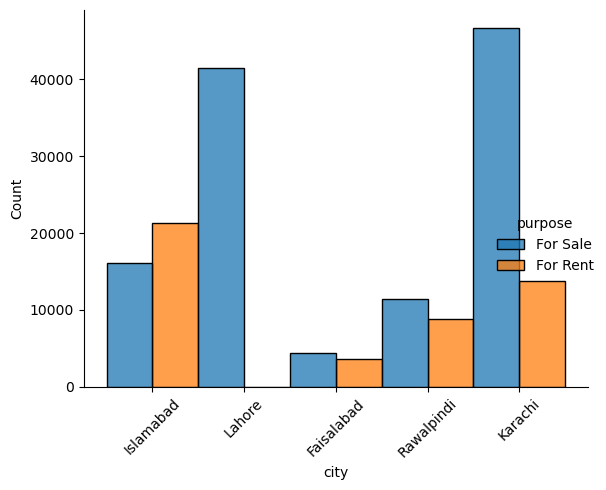

In [231]:
plt.figure(figsize=(20, 12))
sns.displot(df, x="city", hue="purpose", multiple="dodge")


plt.tick_params(axis='x', rotation=45)  # Rotate the x-axis labels by 45 degrees
plt.tight_layout()  # Adjust the spacing to prevent overlapping
plt.show()


<Figure size 1400x800 with 0 Axes>

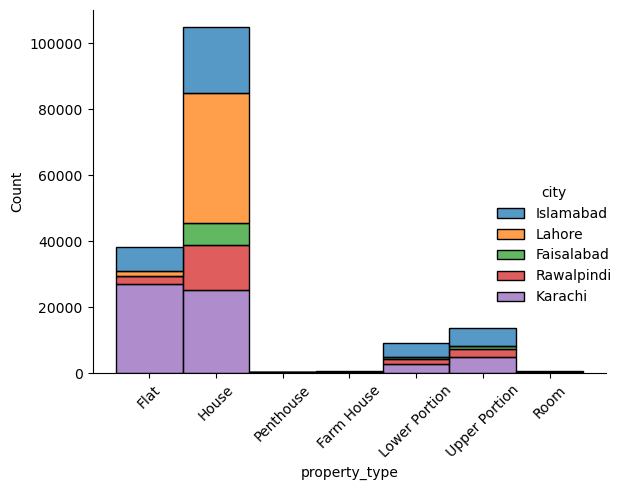

In [232]:
plt.figure(figsize=(14, 8))
sns.displot(df, x="property_type", hue="city", multiple="stack")
plt.xticks(rotation=45)  # Rotate the x-axis labels by 45 degrees
plt.tight_layout()  # Adjust the spacing to prevent overlapping
plt.show()


In [233]:
!pip install geopandas

Defaulting to user installation because normal site-packages is not writeable


In [234]:
import geopandas as gpd

In [235]:
map_boundaries = gpd.read_file('C:/Users/ashis/OneDrive/Desktop/Data Science/Datasets/pakistan_districts_province_boundries.geojson')

In [236]:
# Assuming your dataset is in a DataFrame called 'df' with columns 'longitude', 'latitude', and 'price'
gdf = gpd.GeoDataFrame(df, geometry=gpd.points_from_xy(df['longitude'], df['latitude']), crs='EPSG:4326')
gdf = gdf[['longitude', 'latitude', 'price', 'geometry']]

In [237]:
# Define a function to format the price values
def format_price(price):
    return f'${int(price/10**6)}m'

# Apply the function to the 'price' column in the GeoDataFrame
gdf['price'] = gdf['price'].apply(lambda x: format_price(x) if x < 7e7 else '70m+')


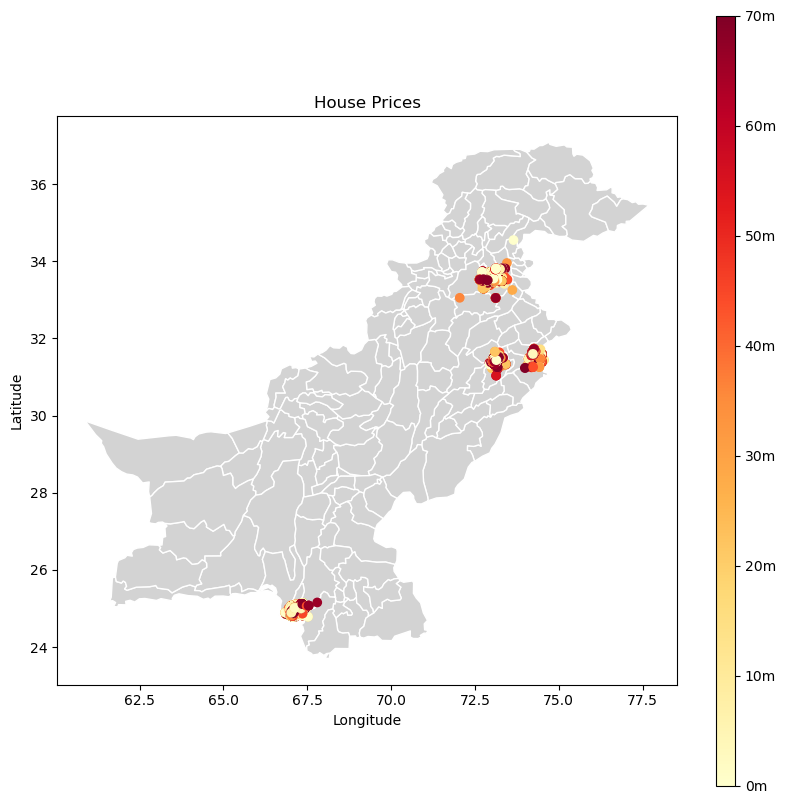

In [238]:
joined_gdf = gpd.sjoin(gdf, map_boundaries, how='inner', predicate='intersects')


# Plot the map with house prices
fig, ax = plt.subplots(figsize=(10, 10))
map_boundaries.plot(ax=ax, color='lightgray', edgecolor='white')
joined_gdf.plot(ax=ax, column='price', cmap='YlOrRd')

# Customize the plot appearance (optional)
plt.title('House Prices')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

ticks = [i for i in range(0, 71, 10)]  # Generate ticks in increments of 10
tick_labels = [f'{i}m' for i in range(0, 71, 10)]  # Generate tick labels
cbar = plt.colorbar(ax.collections[1], orientation='vertical', aspect=40)
cbar.set_ticks(ticks)
cbar.set_ticklabels(tick_labels)

plt.show()

In [239]:
map_boundaries1 = gpd.read_file('C:/Users/ashis/OneDrive/Desktop/Data Science/Datasets/وفاقی دارالحکومت اسلام آباد (Islamabad Capital Territory).geojson')

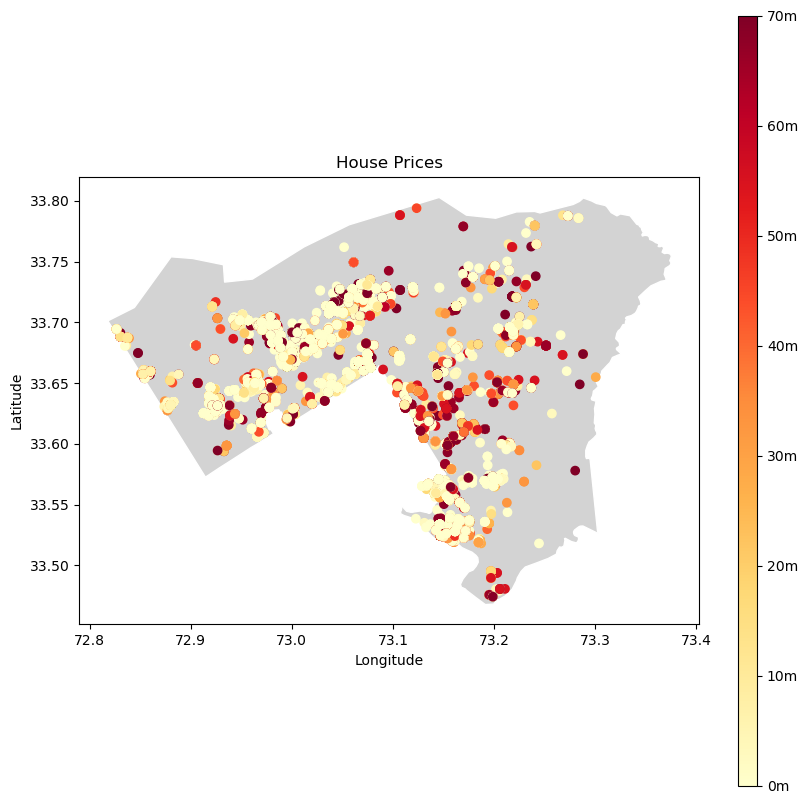

In [240]:
joined_gdf = gpd.sjoin(gdf, map_boundaries1, how='inner', predicate='intersects')


# Plot the map with house prices
fig, ax = plt.subplots(figsize=(10, 10))
map_boundaries1.plot(ax=ax, color='lightgray', edgecolor='white')
joined_gdf.plot(ax=ax, column='price', cmap='YlOrRd')

# Customize the plot appearance (optional)
plt.title('House Prices')
plt.xlabel('Longitude')
plt.ylabel('Latitude')

ticks = [i for i in range(0, 71, 10)]  # Generate ticks in increments of 10
tick_labels = [f'{i}m' for i in range(0, 71, 10)]  # Generate tick labels
cbar = plt.colorbar(ax.collections[1], orientation='vertical', aspect=40)
cbar.set_ticks(ticks)
cbar.set_ticklabels(tick_labels)

plt.show()

In [242]:
print(f"""Skewness: {df.skew()}
Kurtosis: {df.kurt()}""")

C:\Users\ashis\AppData\Local\Temp\ipykernel_12980\1680587159.py:1: FutureWarning:

The default value of numeric_only in DataFrame.skew is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.



Skewness: property_id     -1.940957
location_id      0.565392
price            9.335341
latitude        -0.386632
longitude       -0.539200
baths           25.857004
bedrooms         0.709326
Total_Area     367.196263
dtype: float64
Kurtosis: property_id         4.130019
location_id        -1.014707
price             214.283051
latitude           -1.226191
longitude          -1.154247
baths            4150.267945
bedrooms            8.696310
Total_Area     141708.035011
dtype: float64


C:\Users\ashis\AppData\Local\Temp\ipykernel_12980\1680587159.py:2: FutureWarning:

The default value of numeric_only in DataFrame.kurt is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.



C:\Users\ashis\AppData\Local\Temp\ipykernel_12980\2434146461.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



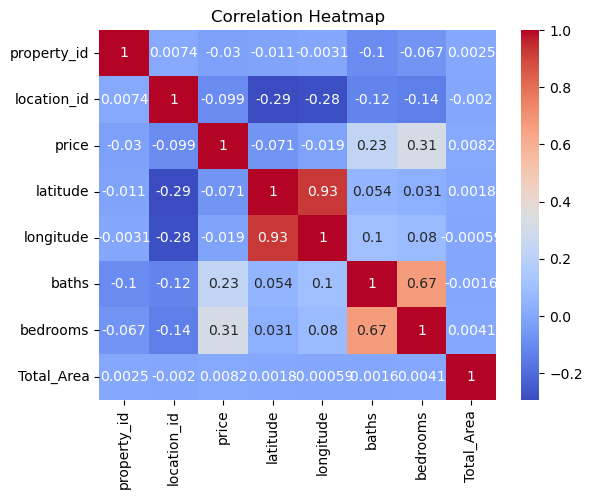

In [243]:

correlation_matrix = df.corr()

# Create a heatmap
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')

# Set the title of the heatmap
plt.title('Correlation Heatmap')

# Display the heatmap
plt.show()


In [244]:
corr_mat = df.corr().price
corr_mat

C:\Users\ashis\AppData\Local\Temp\ipykernel_12980\1839903719.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



property_id   -0.029582
location_id   -0.098610
price          1.000000
latitude      -0.070583
longitude     -0.018814
baths          0.230437
bedrooms       0.314731
Total_Area     0.008167
Name: price, dtype: float64

In [245]:
corr_mat = df.corr().price.sort_values(ascending=False)
corr_mat

C:\Users\ashis\AppData\Local\Temp\ipykernel_12980\748554664.py:1: FutureWarning:

The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.



price          1.000000
bedrooms       0.314731
baths          0.230437
Total_Area     0.008167
longitude     -0.018814
property_id   -0.029582
latitude      -0.070583
location_id   -0.098610
Name: price, dtype: float64

In [ ]:
plt.figure(figsize=(8, 6))
sns.boxplot(x='bedrooms', y='price', data=df, palette='GnBu')

formatter = ticker.FuncFormatter(lambda y, pos: '{:.1f}M'.format(y / 1000000))
plt.gca().yaxis.set_major_formatter(formatter)

title = plt.title('House Price by Bedrooms')

In [ ]:
plt.figure(figsize=(8, 6))
sns.scatterplot(x='bedrooms', y='price', data=df, palette='GnBu')

formatter = ticker.FuncFormatter(lambda y, pos: '{:.1f}M'.format(y / 1000000))
plt.gca().yaxis.set_major_formatter(formatter)

title = plt.title('House Price by Bedrooms')

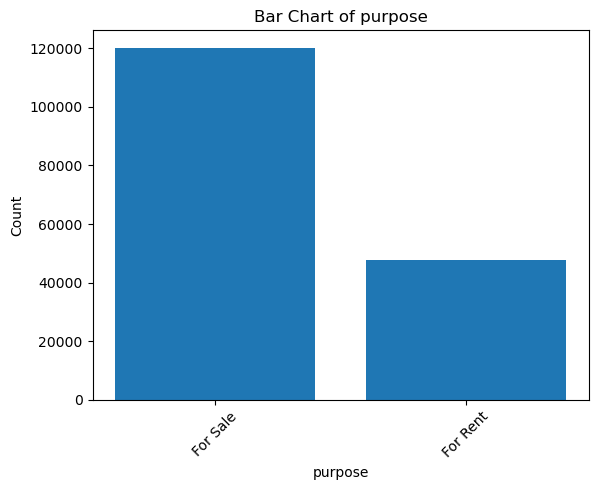

In [247]:
column_name = 'purpose'

# Calculate the counts or frequencies of each unique value in the column
value_counts = df['purpose'].value_counts()

# Create a bar chart
plt.bar(value_counts.index, value_counts.values)

# Add labels and title
plt.xlabel('purpose')
plt.ylabel('Count')
plt.title('Bar Chart of {}'.format('purpose'))

# Rotate x-axis labels if needed
plt.xticks(rotation=45)

# Show the plot
plt.show()






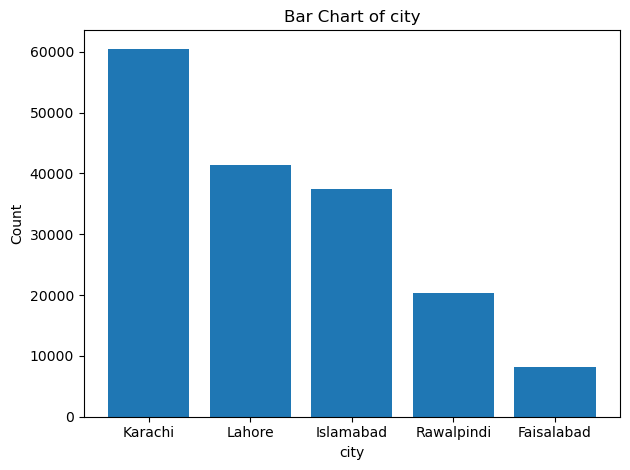

In [248]:


# Calculate the counts or frequencies of each unique value in the column
value_counts = df['city'].value_counts()

# Create a bar chart
plt.bar(value_counts.index, value_counts.values)

# Add labels and title
plt.xlabel('city')
plt.ylabel('Count')
plt.title('Bar Chart of {}'.format('city'))

plt.tight_layout()
plt.show()


In [249]:
import plotly.graph_objs as go
import plotly.offline as py
import plotly.express as px

In [250]:
karachi = pd.read_csv('C:/Users/ashis/OneDrive/Desktop/Data Science/Datasets/pakistan_districts_province_boundries.geojson')

In [260]:
fig = px.scatter_mapbox(karachi,
# Here, plotly gets, (x,y) coordinates
lat=df['latitude'],
lon=df['longitude'],
text=df['city'],

                #Here, plotly detects color of series
                size=df['price'],
                color = df['property_type'],
                labels=df['city'],

                zoom=14.5,
                center={"lat":24.889395, "lon":67.098627},
                height=600,
                width=800)
fig.update_layout(mapbox_style='stamen-terrain')
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.update_layout(title_text="House Prices in Karachi")
fig.show()

In [252]:
df

,property_id,location_id,property_type,price,location,city,province_name,latitude,longitude,baths,purpose,bedrooms,date_added,Total_Area
0,237062,3325,Flat,10000000,G-10,Islamabad,Islamabad Capital,33.679890,73.012640,2,For Sale,2,2/4/2019,1089.004
1,346905,3236,Flat,6900000,E-11,Islamabad,Islamabad Capital,33.700993,72.971492,3,For Sale,3,5/4/2019,15246.056
2,386513,764,House,16500000,G-15,Islamabad,Islamabad Capital,33.631486,72.926559,6,For Sale,5,7/17/2019,2178.008
3,656161,340,House,43500000,Bani Gala,Islamabad,Islamabad Capital,33.707573,73.151199,4,For Sale,4,4/5/2019,10890.000
4,841645,3226,House,7000000,DHA Defence,Islamabad,Islamabad Capital,33.492591,73.301339,3,For Sale,3,7/10/2019,2178.008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168441,17355248,6754,House,26500000,Gadap Town,Karachi,Sindh,25.029909,67.137192,0,For Sale,6,7/18/2019,26136.096
168442,17355249,680,House,12500000,Gadap Town,Karachi,Sindh,25.017951,67.136393,0,For Sale,3,7/18/2019,2178.008
168443,17355250,6757,House,27000000,Gadap Town,Karachi,Sindh,25.015384,67.116330,0,For Sale,6,7/18/2019,26136.096
168444,17355251,6752,House,11000000,Gadap Town,Karachi,Sindh,25.013265,67.120818,0,For Sale,3,7/18/2019,21235.578


In [253]:
df

,property_id,location_id,property_type,price,location,city,province_name,latitude,longitude,baths,purpose,bedrooms,date_added,Total_Area
0,237062,3325,Flat,10000000,G-10,Islamabad,Islamabad Capital,33.679890,73.012640,2,For Sale,2,2/4/2019,1089.004
1,346905,3236,Flat,6900000,E-11,Islamabad,Islamabad Capital,33.700993,72.971492,3,For Sale,3,5/4/2019,15246.056
2,386513,764,House,16500000,G-15,Islamabad,Islamabad Capital,33.631486,72.926559,6,For Sale,5,7/17/2019,2178.008
3,656161,340,House,43500000,Bani Gala,Islamabad,Islamabad Capital,33.707573,73.151199,4,For Sale,4,4/5/2019,10890.000
4,841645,3226,House,7000000,DHA Defence,Islamabad,Islamabad Capital,33.492591,73.301339,3,For Sale,3,7/10/2019,2178.008
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
168441,17355248,6754,House,26500000,Gadap Town,Karachi,Sindh,25.029909,67.137192,0,For Sale,6,7/18/2019,26136.096
168442,17355249,680,House,12500000,Gadap Town,Karachi,Sindh,25.017951,67.136393,0,For Sale,3,7/18/2019,2178.008
168443,17355250,6757,House,27000000,Gadap Town,Karachi,Sindh,25.015384,67.116330,0,For Sale,6,7/18/2019,26136.096
168444,17355251,6752,House,11000000,Gadap Town,Karachi,Sindh,25.013265,67.120818,0,For Sale,3,7/18/2019,21235.578


In [80]:
df1 = data.drop(data.columns[0], axis=1)

In [81]:
data

,property_type,price,city,baths,purpose,bedrooms
0,Flat,10000000,Islamabad,2,For Sale,2
1,Flat,6900000,Islamabad,3,For Sale,3
2,House,16500000,Islamabad,6,For Sale,5
3,House,43500000,Islamabad,4,For Sale,4
4,House,7000000,Islamabad,3,For Sale,3
...,...,...,...,...,...,...
168441,House,26500000,Karachi,0,For Sale,6
168442,House,12500000,Karachi,0,For Sale,3
168443,House,27000000,Karachi,0,For Sale,6
168444,House,11000000,Karachi,0,For Sale,3


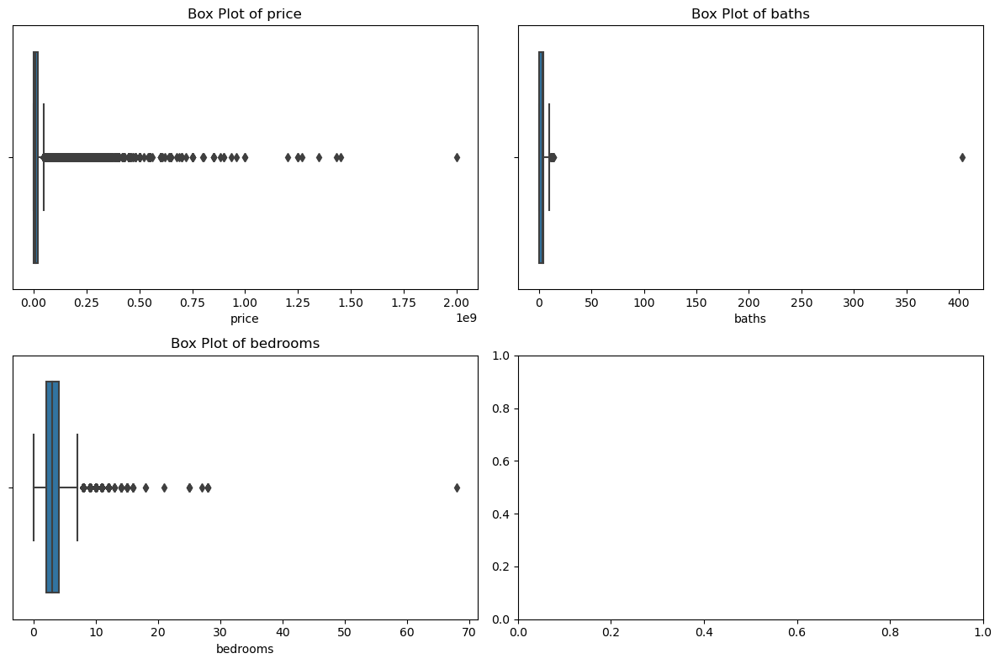

In [121]:


columns = ['price', 'baths', 'bedrooms']
num_columns = 2
num_rows = len(columns) // num_columns + (len(columns) % num_columns > 0)  # Calculate the number of rows for the subplots

fig, axs = plt.subplots(num_rows, num_columns, figsize=(12, 8))  # Create the subplots

for i, column in enumerate(columns):
    row = i // num_columns  # Calculate the row index for the subplot
    col = i % num_columns  # Calculate the column index for the subplot
    
    ax = axs[row, col]  # Select the current subplot
    
    sns.boxplot(data=data, x=columns[i], ax=ax)  # Create the boxplot in the current subplot
    
    # Add a title and change xlabel
    ax.set_title(f'Box Plot of {columns[i]}')
    ax.set_xlabel(columns[i])

plt.tight_layout()  # Ensures proper spacing between subplots
plt.show()  # Display the plot


In [128]:
data = data[data['bedrooms'] <= 30]
data = data[data['baths'] <= 30]

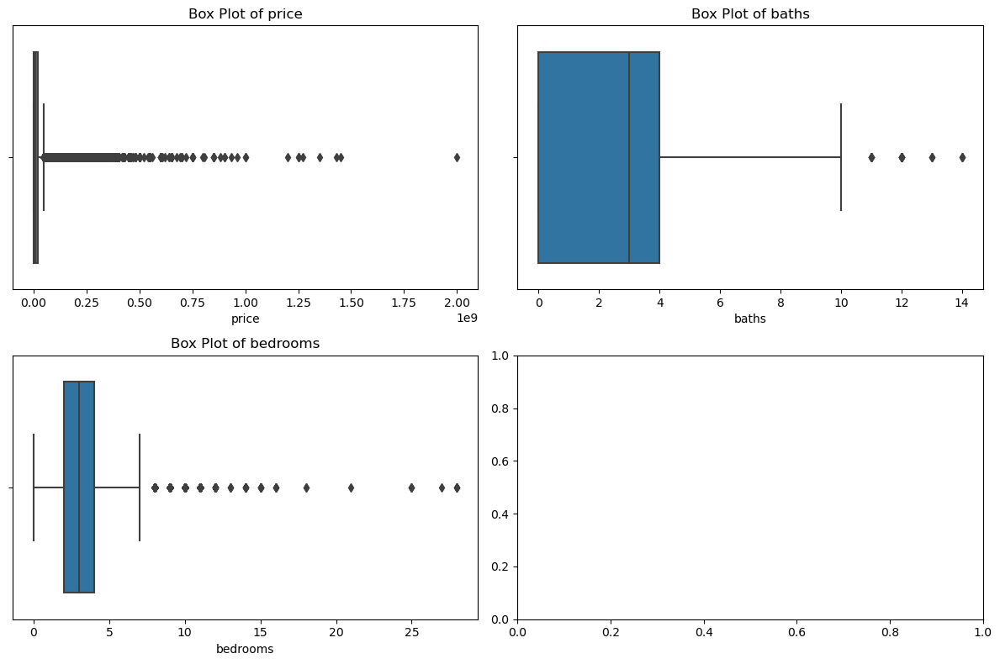

In [129]:


columns = ['price', 'baths', 'bedrooms']
num_columns = 2
num_rows = len(columns) // num_columns + (len(columns) % num_columns > 0)  # Calculate the number of rows for the subplots

fig, axs = plt.subplots(num_rows, num_columns, figsize=(12, 8))  # Create the subplots

for i, column in enumerate(columns):
    row = i // num_columns  # Calculate the row index for the subplot
    col = i % num_columns  # Calculate the column index for the subplot
    
    ax = axs[row, col]  # Select the current subplot
    
    sns.boxplot(data=data, x=columns[i], ax=ax)  # Create the boxplot in the current subplot
    
    # Add a title and change xlabel
    ax.set_title(f'Box Plot of {columns[i]}')
    ax.set_xlabel(columns[i])

plt.tight_layout()  # Ensures proper spacing between subplots
plt.show()  # Display the plot


In [124]:
from scipy.stats import zscore
import numpy as np

# Define the columns for which you want to find outliers
columns = ['price', 'baths', 'bedrooms']

# Initialize an empty DataFrame to store the outliers
outliers = pd.DataFrame()

for column in columns:
    # Calculate z-scores for the current column
    z_scores = zscore(data[column])
    
    # Compute the absolute z-scores
    abs_z_scores = np.abs(z_scores)
    
    # Create a boolean mask for outliers using a threshold of 3
    outlier_mask = (abs_z_scores > 3)
    
    # Select the outliers for the current column and add them to the outliers DataFrame
    column_outliers = data[outlier_mask]
    outliers = pd.concat([outliers, column_outliers])

# Display the outliers for each column separately
for column in columns:
    column_outliers = outliers[outliers[column].notnull()]  # Filter out NaN values
    print(f'Outliers for {column}:')
    print(column_outliers)
    print(f'Number of outliers for {column}: {len(column_outliers)}')


Outliers for price:
       property_type      price       city  baths   purpose  bedrooms
12             House  400000000  Islamabad      0  For Sale         0
31             House  220000000  Islamabad     10  For Sale        10
34             House  230000000  Islamabad      4  For Sale         4
47             House  220000000     Lahore      0  For Sale         0
50             House  125000000     Lahore      7  For Sale         8
...              ...        ...        ...    ...       ...       ...
168147         House     540000  Islamabad     10  For Rent        11
168324         House    1000000  Islamabad     10  For Rent        11
168338         House    1450000  Islamabad     10  For Rent        11
168339         House    1000000  Islamabad     10  For Rent        10
168341         House    1000000  Islamabad     10  For Rent        10

[4089 rows x 6 columns]
Number of outliers for price: 4089
Outliers for baths:
       property_type      price       city  baths   purpose 

In [126]:
# Calculate the percentiles
seventy_fifth = data['price'].quantile(0.75)
twenty_fifth = data['price'].quantile(0.25)

# Obtain IQR
iqr = seventy_fifth - twenty_fifth

# Upper and lower thresholds
upper = seventy_fifth + (1.5 * iqr)
lower = twenty_fifth - (1.5 * iqr)

# Subset the dataset
outliers = data[(data['price'] < lower) | (data['price'] > upper)]
outliers.head()

# Obtain number of outliers
print(f'Number of outliers: {len(outliers)}')

Number of outliers: 13543


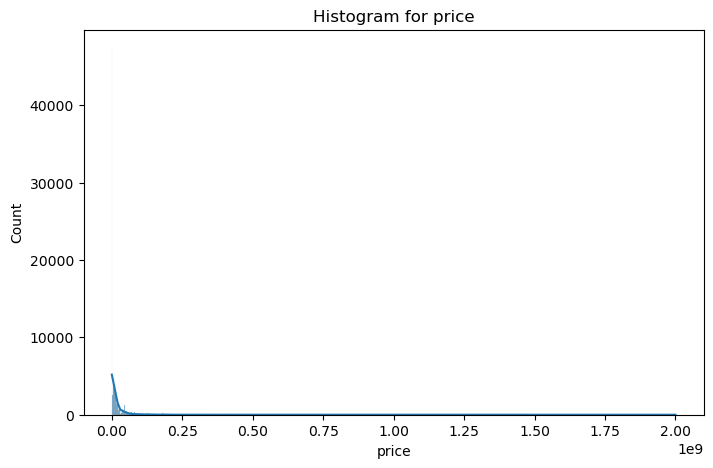

In [130]:
column_name = 'price'

# Create a histogram
plt.figure(figsize=(8, 5))
sns.histplot(data=data, x=column_name, kde=True)
plt.title(f'Histogram for {column_name}')
plt.show()

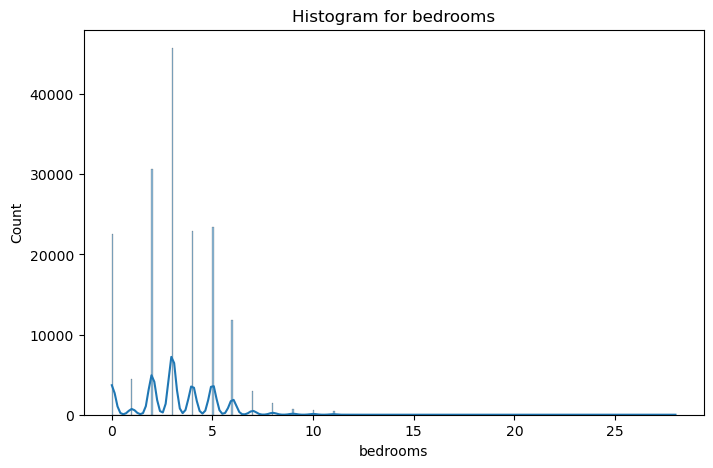

In [131]:
column_name = 'bedrooms'

# Create a histogram
plt.figure(figsize=(8, 5))
sns.histplot(data=data, x=column_name, kde=True)
plt.title(f'Histogram for {column_name}')
plt.show()

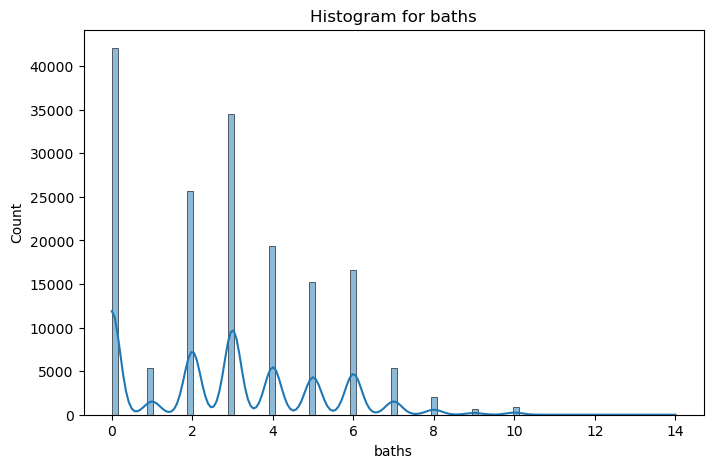

In [133]:
column_name = 'baths'

# Create a histogram
plt.figure(figsize=(8, 5))
sns.histplot(data=data, x=column_name, kde=True)
plt.title(f'Histogram for {column_name}')
plt.show()

In [134]:
df_encoded = pd.get_dummies(data, columns=['property_type', 'city','purpose',], prefix=['property_type', 'city','purpose'])

# Display the encoded DataFrame
print(df_encoded)

           price  baths  bedrooms  property_type_Farm House  \
0       10000000      2         2                         0   
1        6900000      3         3                         0   
2       16500000      6         5                         0   
3       43500000      4         4                         0   
4        7000000      3         3                         0   
...          ...    ...       ...                       ...   
168441  26500000      0         6                         0   
168442  12500000      0         3                         0   
168443  27000000      0         6                         0   
168444  11000000      0         3                         0   
168445   9000000      3         3                         0   

        property_type_Flat  property_type_House  property_type_Lower Portion  \
0                        1                    0                            0   
1                        1                    0                            0   
2  

In [181]:
df_encoded.isnull().sum()

price                          0
baths                          0
bedrooms                       0
property_type_Farm House       0
property_type_Flat             0
property_type_House            0
property_type_Lower Portion    0
property_type_Penthouse        0
property_type_Room             0
property_type_Upper Portion    0
city_Faisalabad                0
city_Islamabad                 0
city_Karachi                   0
city_Lahore                    0
city_Rawalpindi                0
purpose_For Rent               0
purpose_For Sale               0
dtype: int64

In [186]:
df_encoded.reset_index(drop=True, inplace=True)  # Reset index to match NumPy array


In [187]:
from sklearn.preprocessing import RobustScaler
scaler = RobustScaler()

columns_to_scale = ['price', 'baths', 'bedrooms']
scaled_data = scaler.fit_transform(df_encoded[columns_to_scale])

scaled_df = pd.DataFrame(scaled_data, columns=columns_to_scale)

result_df = pd.concat([scaled_df, df_encoded.drop(columns=columns_to_scale)], axis=1)

In [188]:
result_df

,price,baths,bedrooms,property_type_Farm House,property_type_Flat,property_type_House,property_type_Lower Portion,property_type_Penthouse,property_type_Room,property_type_Upper Portion,city_Faisalabad,city_Islamabad,city_Karachi,city_Lahore,city_Rawalpindi,purpose_For Rent,purpose_For Sale
0,0.077620,-0.25,-0.5,0,1,0,0,0,0,0,0,1,0,0,0,0,1
1,-0.082794,0.00,0.0,0,1,0,0,0,0,0,0,1,0,0,0,0,1
2,0.413972,0.75,1.0,0,0,1,0,0,0,0,0,1,0,0,0,0,1
3,1.811125,0.25,0.5,0,0,1,0,0,0,0,0,1,0,0,0,0,1
4,-0.077620,0.00,0.0,0,0,1,0,0,0,0,0,1,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
167770,0.931436,-0.75,1.5,0,0,1,0,0,0,0,0,0,1,0,0,0,1
167771,0.206986,-0.75,0.0,0,0,1,0,0,0,0,0,0,1,0,0,0,1
167772,0.957309,-0.75,1.5,0,0,1,0,0,0,0,0,0,1,0,0,0,1
167773,0.129366,-0.75,0.0,0,0,1,0,0,0,0,0,0,1,0,0,0,1


In [189]:
X = result_df[['baths', 'bedrooms', 'property_type_Farm House', 'property_type_Flat', 'property_type_House', 'property_type_Lower Portion', 'property_type_Penthouse', 'property_type_Room', 'property_type_Upper Portion', 'city_Faisalabad', 'city_Islamabad', 'city_Karachi', 'city_Lahore', 'city_Rawalpindi', 'purpose_For Rent', 'purpose_For Sale']]  # Replace 'target_column_name' with your actual target column
y = result_df['price']


In [190]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [191]:
print("Train set shape:", X_train.shape, y_train.shape)
print("Test set shape:", X_test.shape, y_test.shape)


Train set shape: (134220, 16) (134220,)
Test set shape: (33555, 16) (33555,)
